# 3DeeCellTracker Demo: Train 3D U-Net
This notebook shows how to use 3DeeCellTracker to train a 3D U-Net.
The demo data can be found in the "unet_training" folder downloaded from https://osf.io/dt76c/

The basic procedures:

- A. Import packages
- B. Initialize the parameters for training
- C. Load the train / validation datasets
- D. Preprocess the datasets
- E. Train the 3D U-Net
- F. Select the best weights and save the model

Please run following codes according to the instructions

## A. Import packages

In [1]:
%load_ext autoreload
%autoreload 2
import os
import warnings
warnings.filterwarnings('ignore')
from CellTracker.unet3d import TrainingUNet3D, unet3_a
%matplotlib inline

## B. Initialize the parameters for training
- noise_level: This value should be roughly the intensity of the background pixels in the raw image. It is used in
normalization to enhance the cells with weak intensity while ignore the background noises. If the two images (train and
validation) have different noise level, choose a value somehow between them.

- folder_path: This path is used to create a folder (if not exist) to store the data and model files. We recommend users
to set it as “./xxxx” to create a folder named xxxx under the same directory containing the notebook file.

- model: This should be a predefined 3D U-Net model. The simplest way is to use the default value unet3_a(). Advanced
users can select other predefined model such as unet3_b(), unet3_c(), or a model defined by themselves (need to modify
the “Import packages” cell to import the model).

In [2]:
trainer = TrainingUNet3D(noise_level=100, folder_path=os.path.abspath("./unet_01"), model=unet3_a())

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Made folders under: C:\Users\vislabwwy\test\3DeeCellTracker\Examples
Following folders were made: 
unet_01\train_image
unet_01\train_label
unet_01\valid_image
unet_01\valid_label
unet_01\models
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## C. Load the train / validation datasets

After running B, the program automatically generated several folders under the folder_path. Users should prepare the
training data and validation data (see examples in the demo data) and store them into the “train_image”(raw 2D image
sequence for training data), “train_label”(2D annotation of cell/non-cell regions for training data), “valid_image” and
“valid_label” (for validation data), respectively.


Run the code cell. The program will load and draw the images/annotations of the training and validation dataset by max-projection.

Load images with shape: (256, 1024, 36)
Load images with shape: (256, 1024, 36)
Load images with shape: (256, 1024, 36)
Load images with shape: (256, 1024, 36)


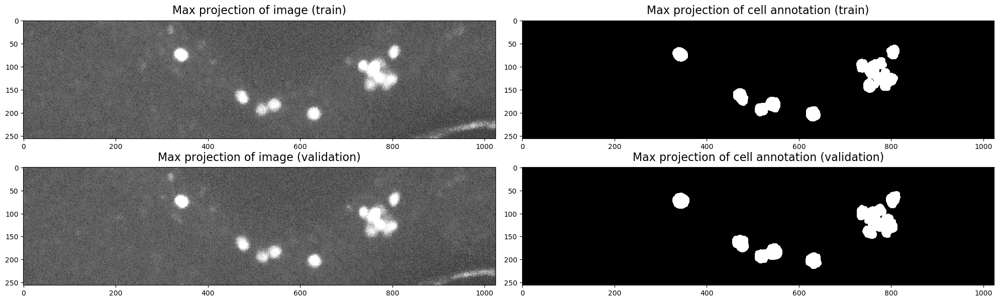

In [3]:
trainer.load_dataset()
trainer.draw_dataset()

## D. Preprocess the datasets
**D1. Show the normalized images (max projection)**

Normalize the images and show the normalized images.
If the normalization looks poor, e.g. the background look too bright, or the intensity of weak cells are not enhanced.
Please go back to step B to modify the parameter “noise_level” and run all codes again.

Images were normalized
Images were divided
Data for training 3D U-Net were prepared


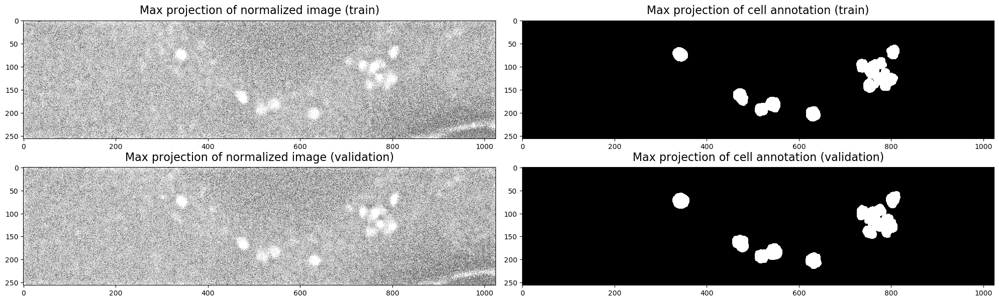

In [4]:
trainer.preprocess()
trainer.draw_norm_dataset()

**D2. Show the divided images (part)**

Divide the images into multiple sub-images (used as the input of 3D U-Net) and show a part of these sub-images.

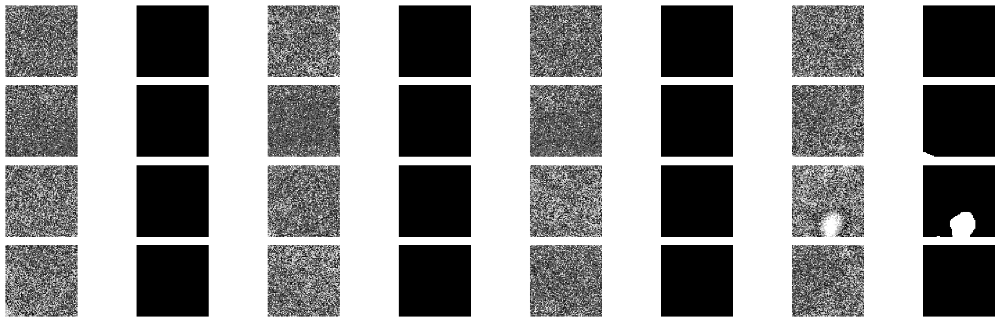

In [5]:
trainer.draw_divided_train_data()

## E. Train the 3D U-Net
Start to train the 3D U-Net. During the training, the program will draw the updated prediction of cell regions if the
loss on validation data is reduced.

By default, the program will train for 100 epochs. Users can manually stop the training by pressing Ctrl+C if the
val_loss no longer decreases anymore.

60/60 [==============================] - 18s 293ms/step - loss: 0.6401 - val_loss: 0.7097
val_loss at step 1:  0.7097260535821407


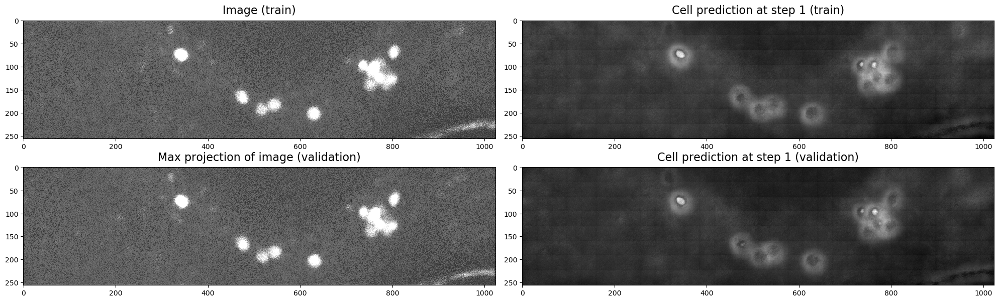

60/60 [==============================] - 12s 203ms/step - loss: 0.4918 - val_loss: 0.3219
val_loss updated from  0.7097260535821407  to  0.3218730938505139


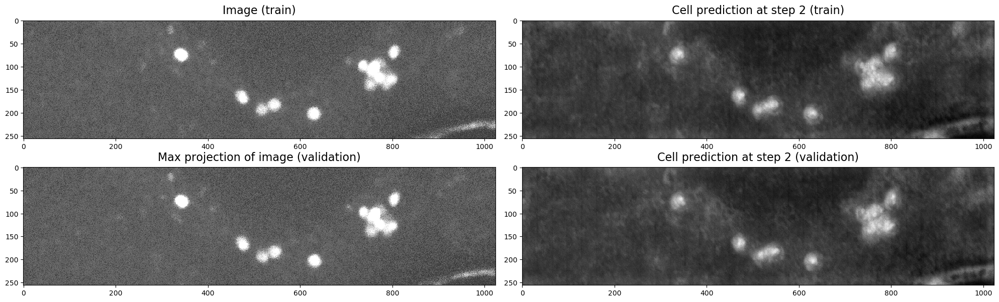

60/60 [==============================] - 12s 203ms/step - loss: 0.2683 - val_loss: 0.1314
val_loss updated from  0.3218730938505139  to  0.13135332067513608


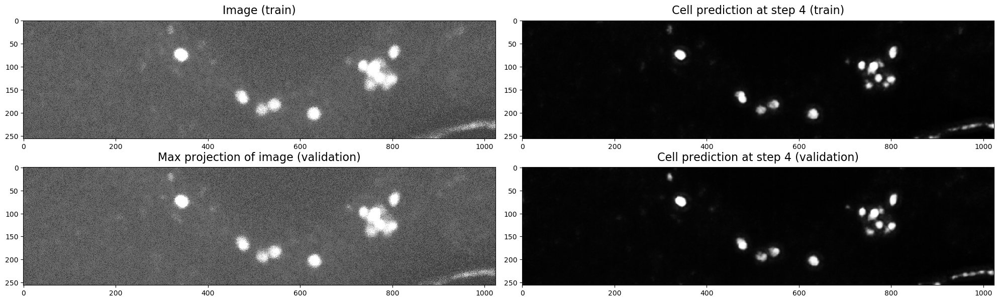

60/60 [==============================] - 12s 202ms/step - loss: 0.1878 - val_loss: 0.1192
val_loss updated from  0.13135332067513608  to  0.11919676807857829


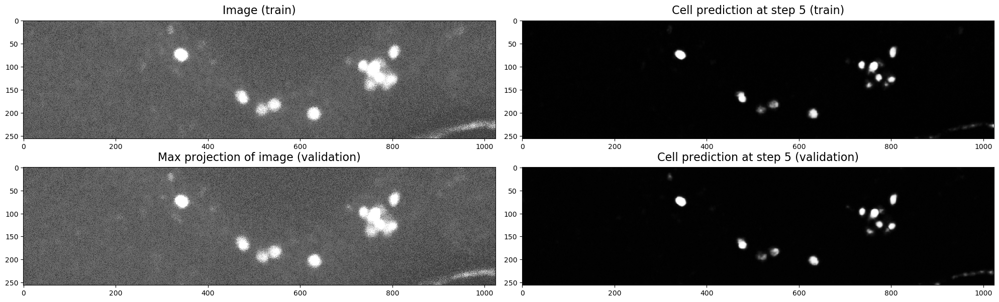

60/60 [==============================] - 12s 204ms/step - loss: 0.1000 - val_loss: 0.0621
val_loss updated from  0.11919676807857829  to  0.06208176346572899


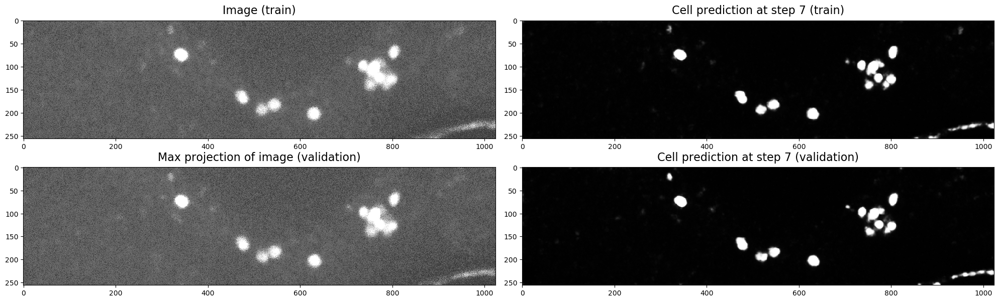

60/60 [==============================] - 12s 202ms/step - loss: 0.0756 - val_loss: 0.0570
val_loss updated from  0.06208176346572899  to  0.057021751052000115


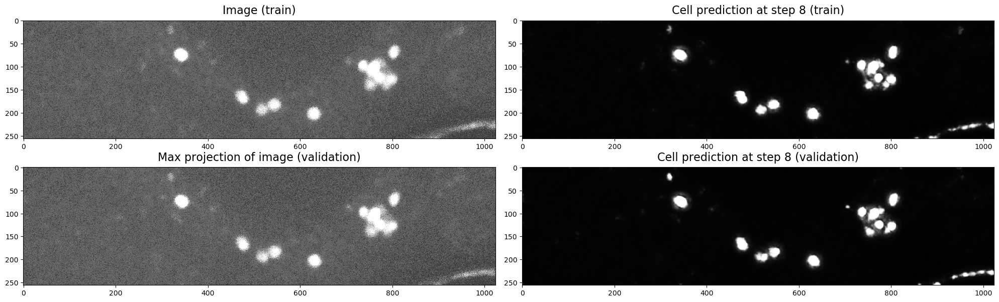

60/60 [==============================] - 12s 202ms/step - loss: 0.0572 - val_loss: 0.0516
val_loss updated from  0.057021751052000115  to  0.05157459597792146


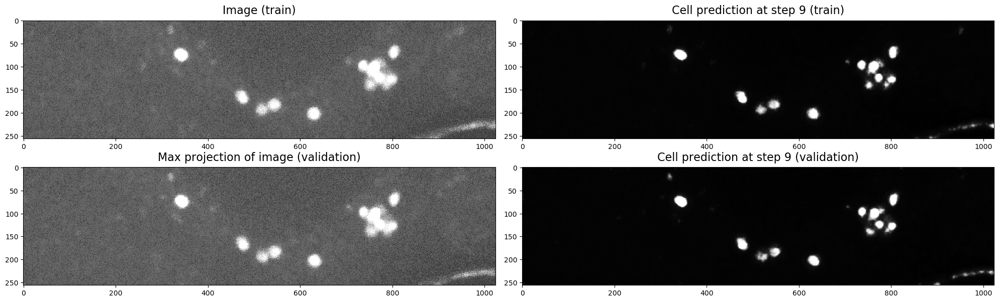

60/60 [==============================] - 12s 206ms/step - loss: 0.0492 - val_loss: 0.0400
val_loss updated from  0.05157459597792146  to  0.04004534929109043


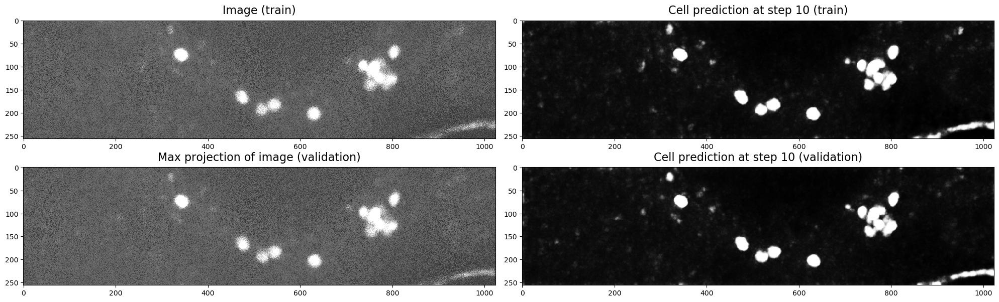

60/60 [==============================] - 12s 203ms/step - loss: 0.0345 - val_loss: 0.0371
val_loss updated from  0.04004534929109043  to  0.03710154630243778


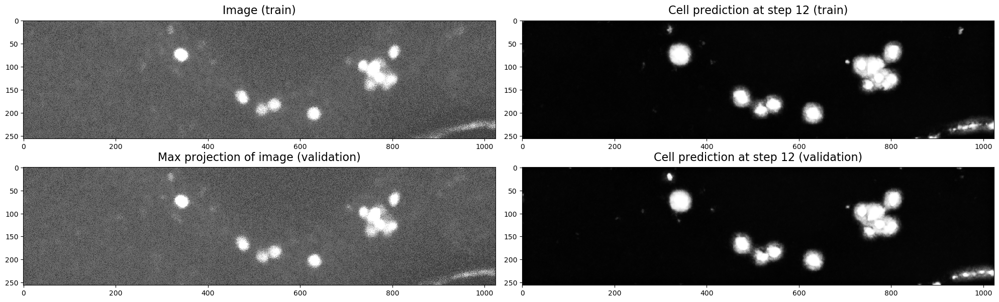

60/60 [==============================] - 12s 203ms/step - loss: 0.0270 - val_loss: 0.0245
val_loss updated from  0.03710154630243778  to  0.024491282389361477


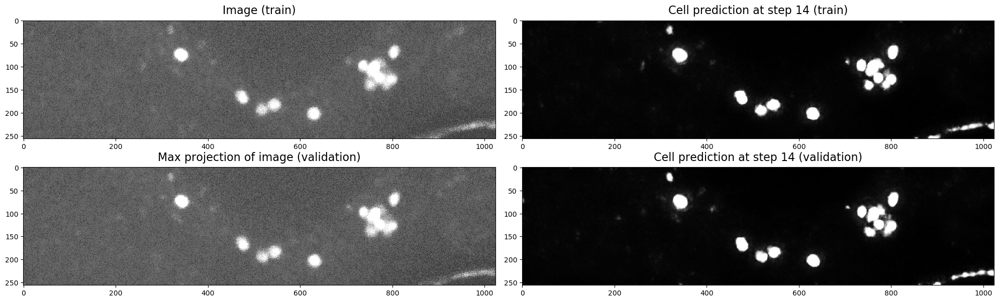

60/60 [==============================] - 12s 203ms/step - loss: 0.0198 - val_loss: 0.0227
val_loss updated from  0.024491282389361477  to  0.02266507054342938


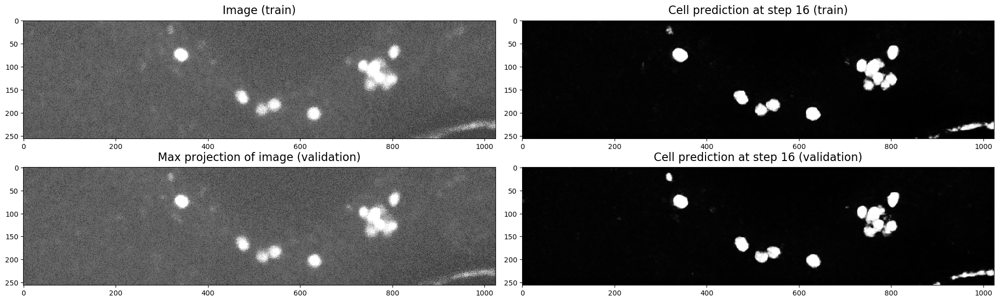

60/60 [==============================] - 12s 205ms/step - loss: 0.0133 - val_loss: 0.0202
val_loss updated from  0.02266507054342938  to  0.020215974109434695


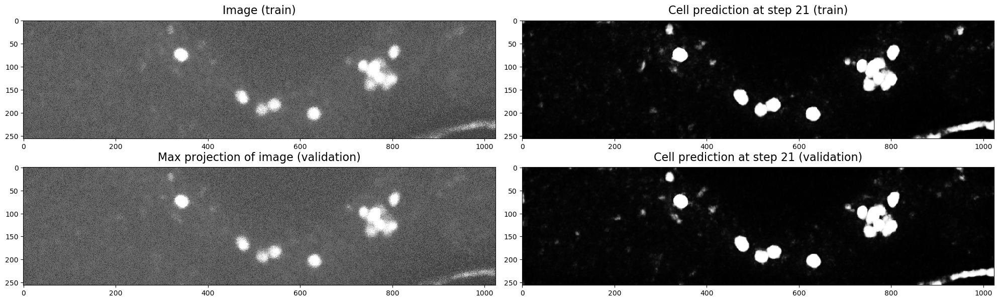

60/60 [==============================] - 12s 202ms/step - loss: 0.0131 - val_loss: 0.0194
val_loss updated from  0.020215974109434695  to  0.019390048844927163


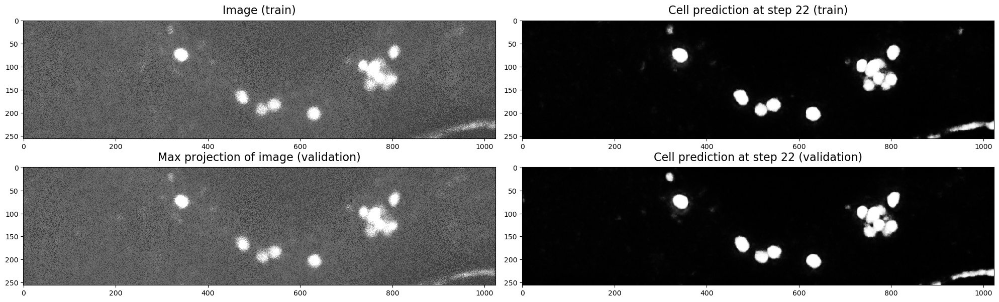

60/60 [==============================] - 12s 204ms/step - loss: 0.0125 - val_loss: 0.0181
val_loss updated from  0.019390048844927163  to  0.018089694345711605


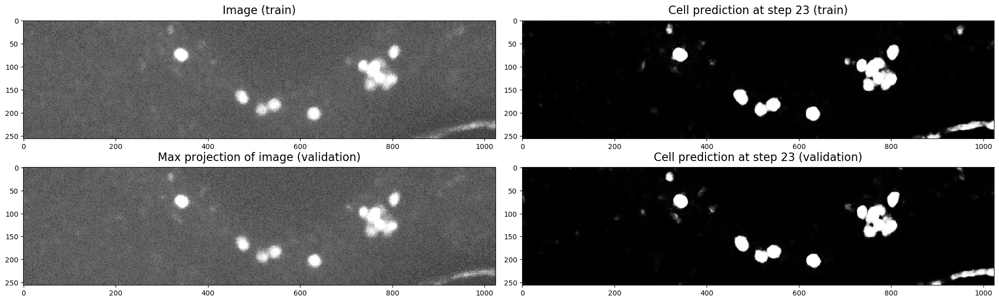

60/60 [==============================] - 12s 205ms/step - loss: 0.0111 - val_loss: 0.0156
val_loss updated from  0.018089694345711605  to  0.015622139304942457


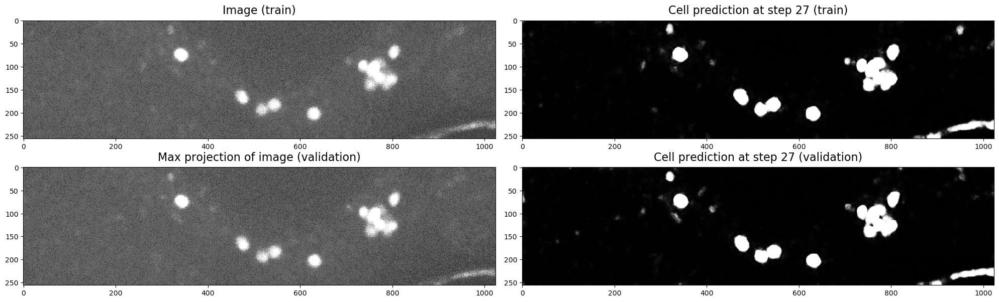

60/60 [==============================] - 12s 204ms/step - loss: 0.0147 - val_loss: 0.0143
val_loss updated from  0.015622139304942457  to  0.01432373615659597


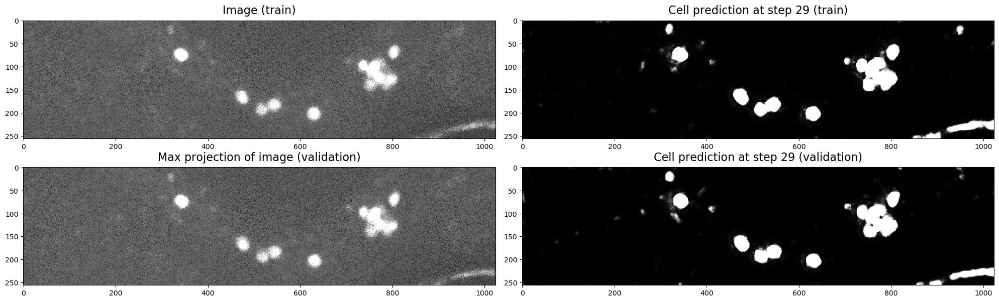

60/60 [==============================] - 12s 203ms/step - loss: 0.0106 - val_loss: 0.0141
val_loss updated from  0.01432373615659597  to  0.014054483323517813


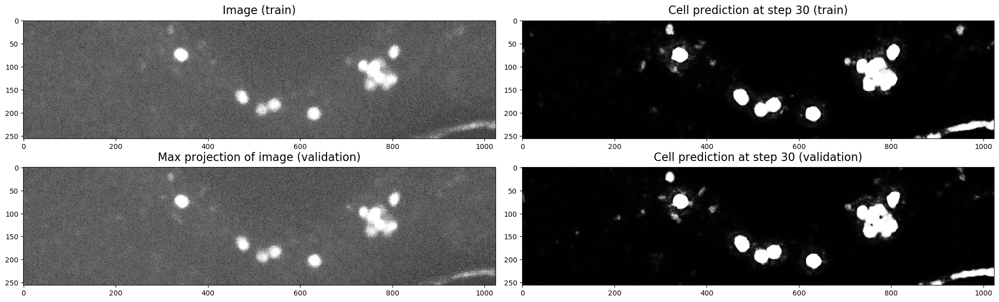

60/60 [==============================] - 12s 203ms/step - loss: 0.0078 - val_loss: 0.0134
val_loss updated from  0.014054483323517813  to  0.013351224733450445


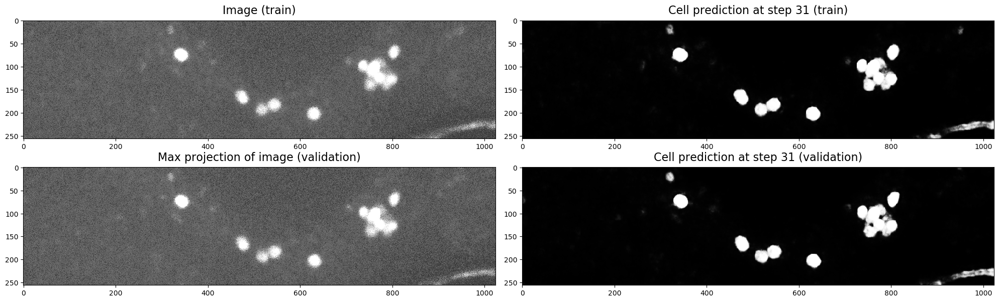

60/60 [==============================] - 12s 205ms/step - loss: 0.0099 - val_loss: 0.0122
val_loss updated from  0.013351224733450445  to  0.012198228707272538


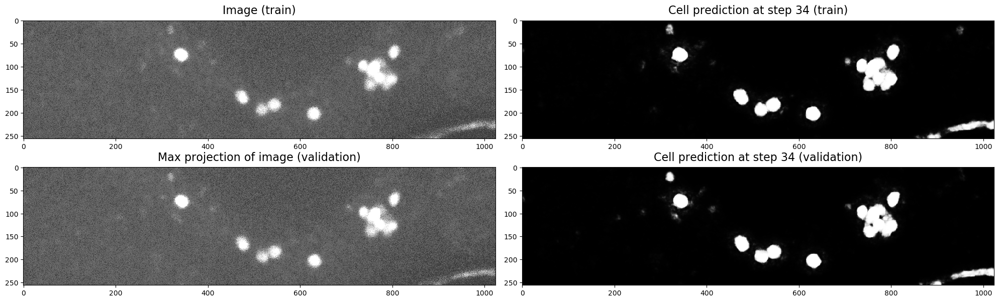

60/60 [==============================] - 12s 203ms/step - loss: 0.0092 - val_loss: 0.0120
val_loss updated from  0.012198228707272538  to  0.011992328289824609


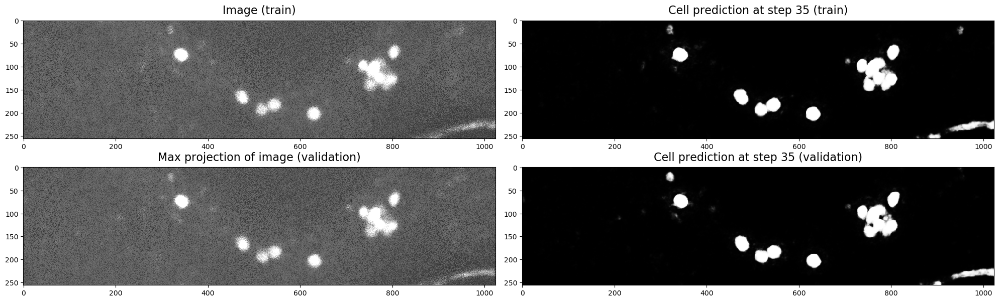

60/60 [==============================] - 12s 203ms/step - loss: 0.0074 - val_loss: 0.0113
val_loss updated from  0.011992328289824609  to  0.011277605541127585


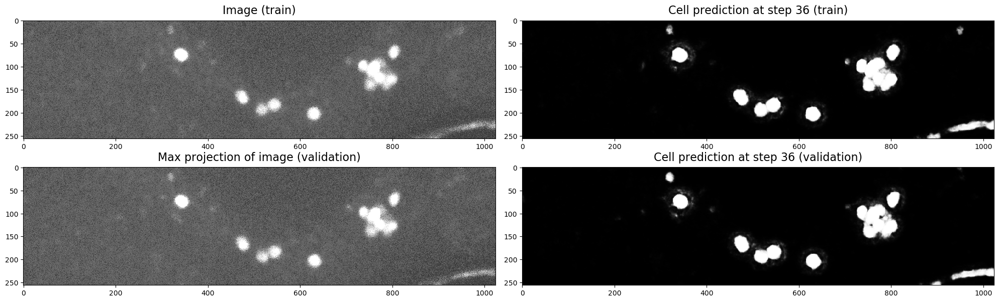

60/60 [==============================] - 12s 206ms/step - loss: 0.0063 - val_loss: 0.0108
val_loss updated from  0.011277605541127585  to  0.010785125547981429


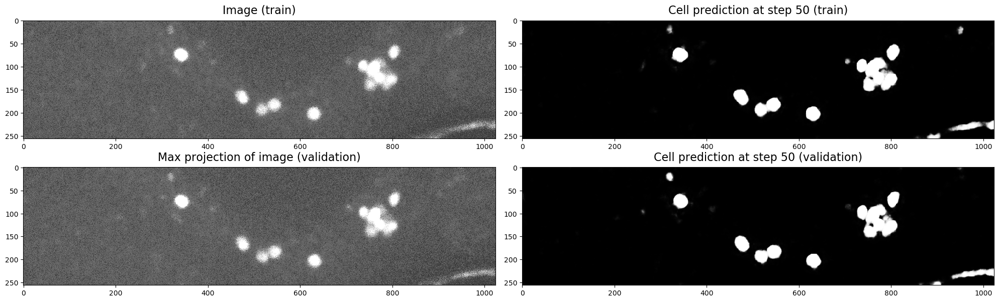

60/60 [==============================] - 12s 206ms/step - loss: 0.0067 - val_loss: 0.0103
val_loss updated from  0.010785125547981429  to  0.01025256352773289


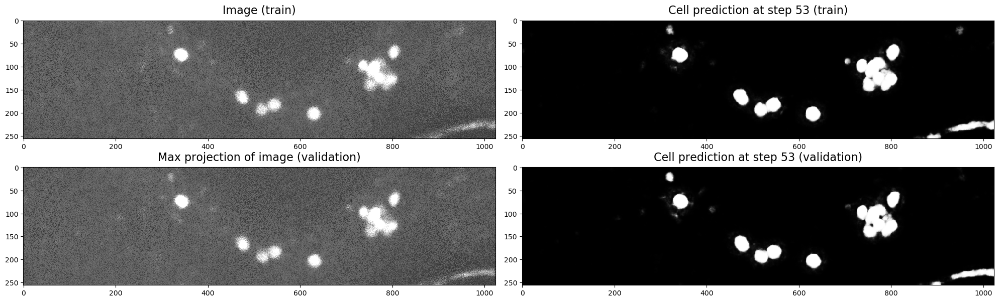

60/60 [==============================] - 12s 206ms/step - loss: 0.0064 - val_loss: 0.0100
val_loss updated from  0.01025256352773289  to  0.009965715740777046


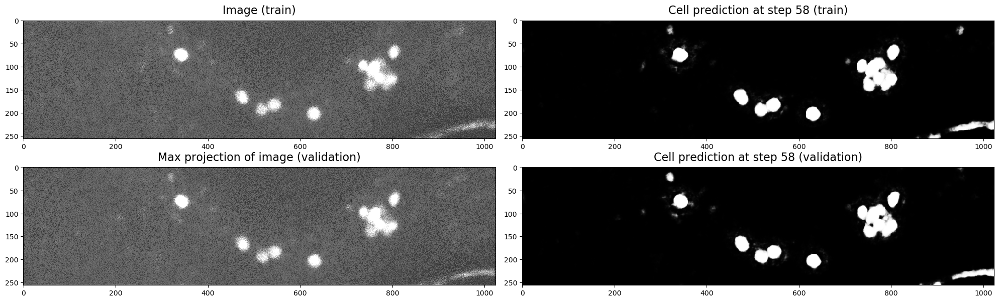

60/60 [==============================] - 15s 246ms/step - loss: 0.0047 - val_loss: 0.0098
val_loss updated from  0.009965715740777046  to  0.009787040214969076


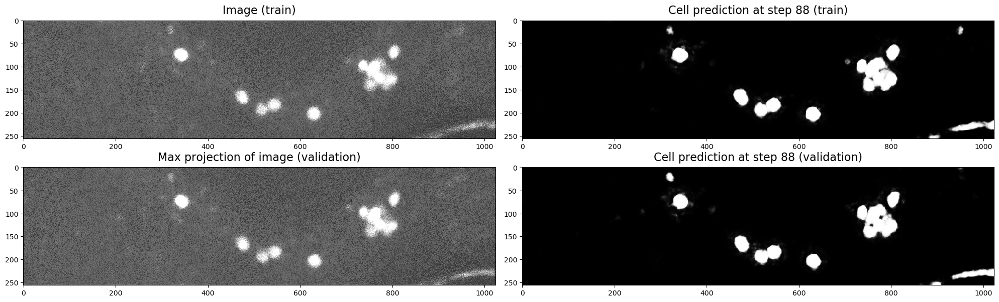

60/60 [==============================] - 15s 250ms/step - loss: 0.0043 - val_loss: 0.0097
val_loss updated from  0.009787040214969076  to  0.00971962406886218


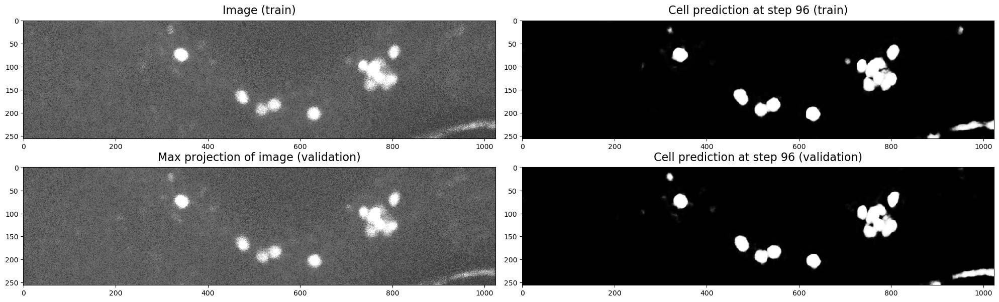

60/60 [==============================] - 15s 246ms/step - loss: 0.0049 - val_loss: 0.0094
val_loss updated from  0.00971962406886218  to  0.009407407063412199


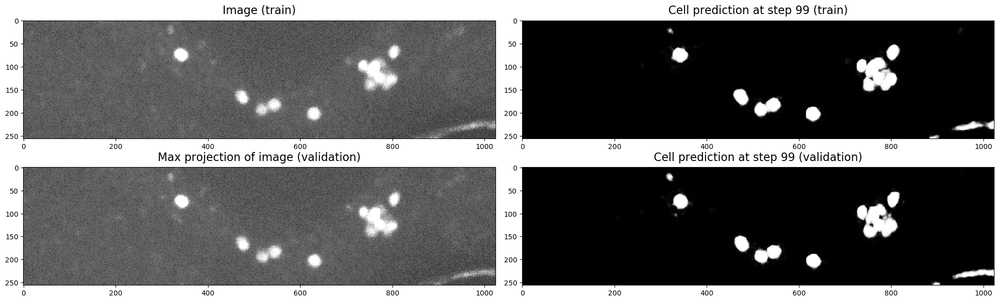

60/60 [==============================] - 15s 244ms/step - loss: 0.0037 - val_loss: 0.0105


In [6]:
trainer.train()

## F. Select the best weights and save the model
After training finished or manually stopped. Users should choose the best step which generate the best prediction of
cell regions. Usually this should be the one with the lowest val_loss, but uses can select other step instead.

The program will store the model with the chosen weights into the “models” folder with the name “unet3_pretrained.h5”

In [7]:
trainer.select_weights(step=99)